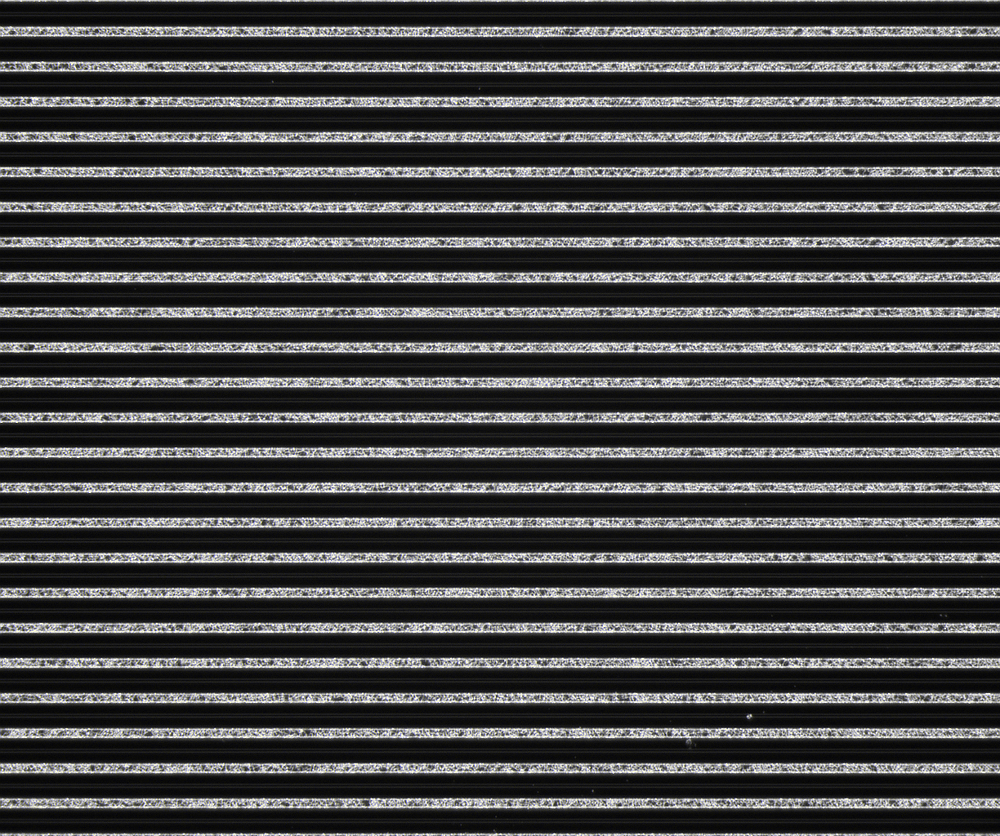

In [1]:
%matplotlib inline
from matplotlib import pyplot as plt
import numpy as np
from PIL import Image

Image.open('VPX32409-W00065_08_09.bmp')

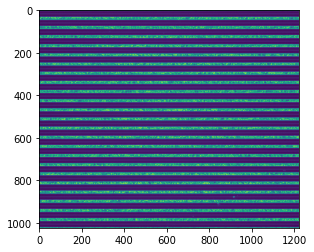

In [2]:
im = Image.open('VPX32409-W00065_08_09.bmp')
p = np.array(im)[:,:,0]

plt.imshow(p)
plt.show()

In [3]:
# Split the image into 64 even pieces
split = np.array([np.vsplit(x, 8) for x in np.hsplit(p, 8)])
print(split.shape)

# Reshape to create different images exist across first dimension of array
split = np.reshape(split, (1, -1, split.shape[2], split.shape[3]))
print(split.shape)
split = np.squeeze(split,0)
print(split.shape)

(8, 8, 128, 153)
(1, 64, 128, 153)
(64, 128, 153)


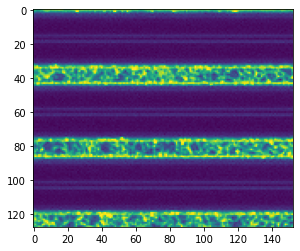

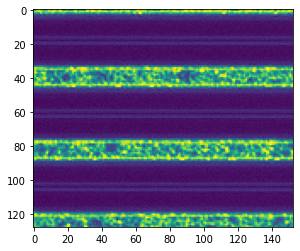

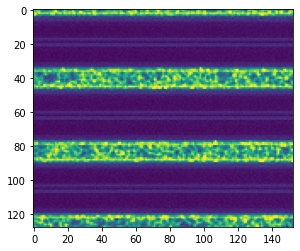

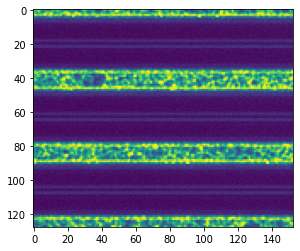

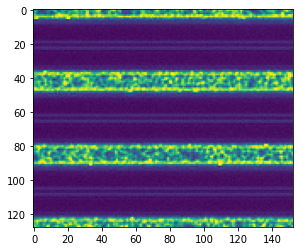

...

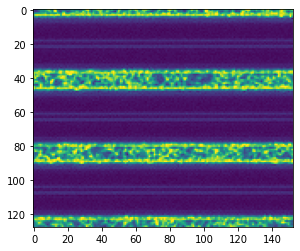

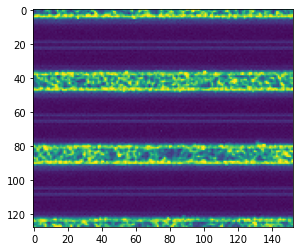

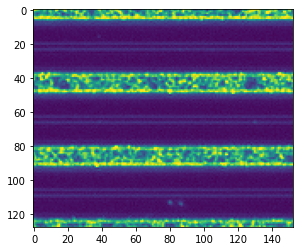

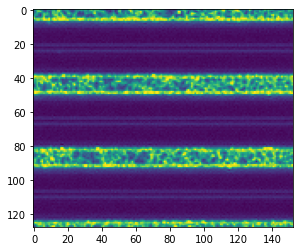

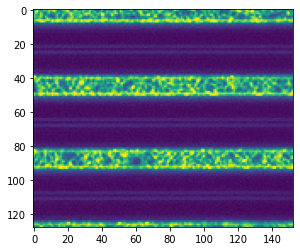

In [4]:
for i in split:
    plt.imshow(i)
    plt.show()

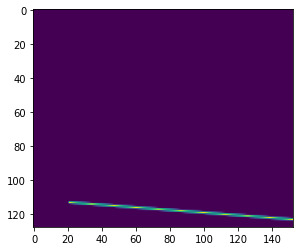

In [5]:
# Add Damage 
# https://stackoverflow.com/questions/31638651/how-can-i-draw-lines-into-numpy-arrays

# import scipy.misc
import numpy as np
from skimage.draw import line_aa
img = np.zeros((128, 153), dtype=np.uint8)
rr, cc, val = line_aa(np.random.randint(0,img.shape[0]), np.random.randint(0,img.shape[1]), np.random.randint(0,img.shape[0]), np.random.randint(0,img.shape[1]))
img[rr, cc] = val * 255

plt.imshow(img)
plt.show()


In [6]:
# This wasn't working for me originally
# ONLY IF THE ABOVE DOES NOT WORK, Uncomment.

# Install a pip package in the current Jupyter kernel
# https://jakevdp.github.io/blog/2017/12/05/installing-python-packages-from-jupyter/

# import sys
# !{sys.executable} -m pip install scikit-image

In [7]:
# TODO: I will come back to this and add different types of damage

def addDamage(img):
    rr, cc, val = line_aa(np.random.randint(0,img.shape[0]), np.random.randint(0,img.shape[1]), np.random.randint(0,img.shape[0]), np.random.randint(0,img.shape[1]))
    img[rr, cc] = val * np.random.randint(0,255)
    return img

In [8]:
# Create a undamaged and a damaged version

undamagedImages = np.copy(split)
damagedImages = [addDamage(img) for img in np.copy(split)]

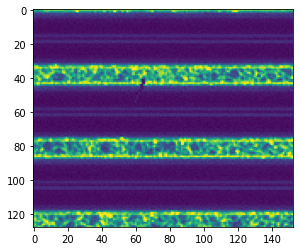

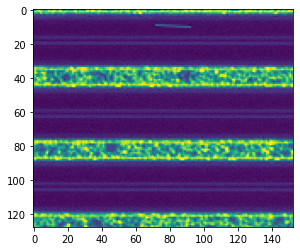

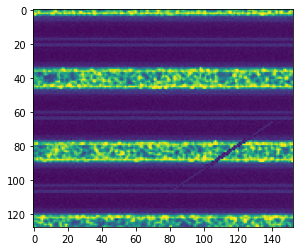

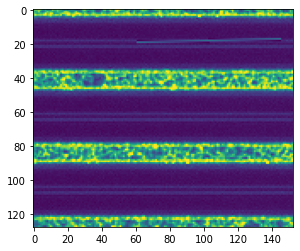

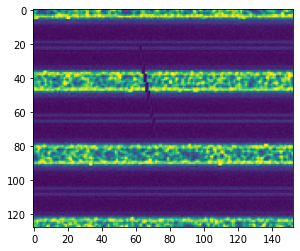

...

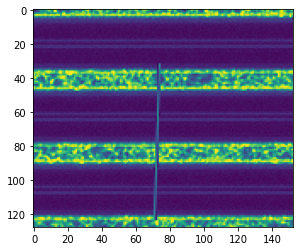

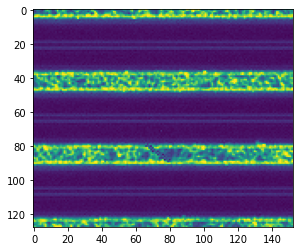

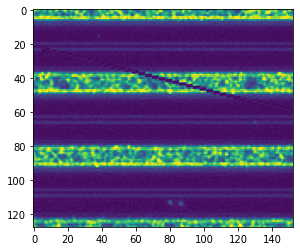

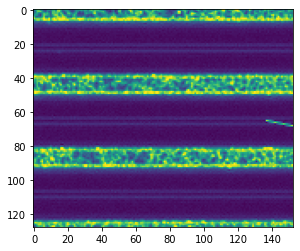

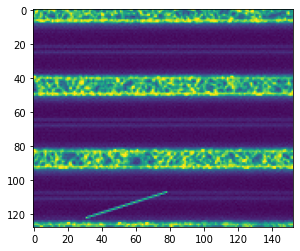

In [9]:


for i in damagedImages:
    plt.imshow(i)
    plt.clim([0,255])
    plt.show()

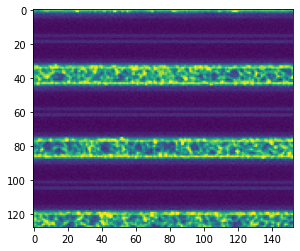

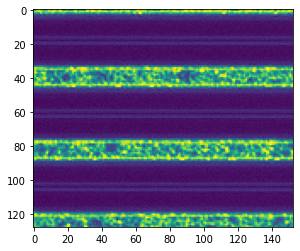

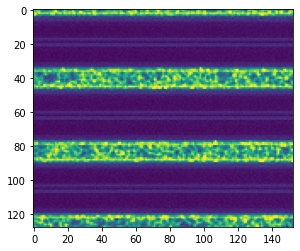

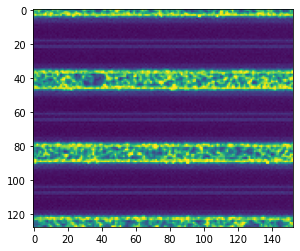

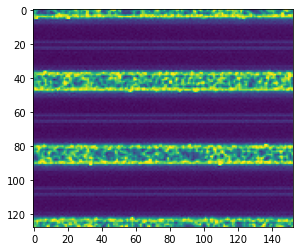

...

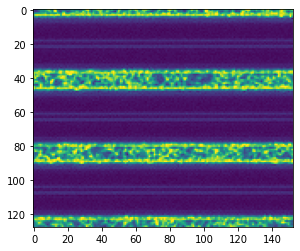

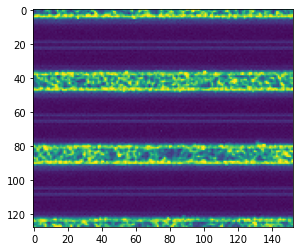

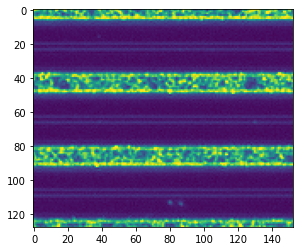

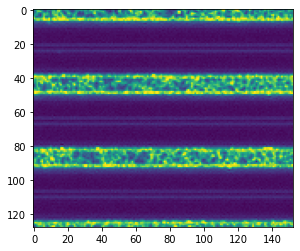

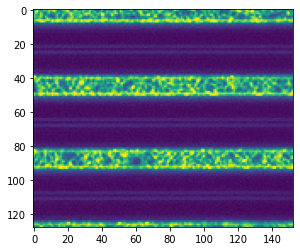

In [10]:
for i in undamagedImages:
    plt.imshow(i)
    plt.clim([0,255])
    plt.show()

In [11]:
fullData = np.concatenate((undamagedImages, damagedImages))
print(len(undamagedImages))

# https://numpy.org/doc/stable/reference/generated/numpy.full.html
fullDataLabels = np.concatenate((np.full((len(undamagedImages),2),[0,1]),
                                np.full((len(damagedImages),2),[1,0])))

print(fullData.shape)
print(fullDataLabels.shape)

64
(128, 128, 153)
(128, 2)


In [12]:
# Shuffle the two lists around:
# https://stackoverflow.com/questions/23289547/shuffle-two-list-at-once-with-same-order
# TODO: See if we can do that thing in the first assignment

import random

c = list(zip(fullData, fullDataLabels))
random.shuffle(c)

fullData, fullDataLabels = zip(*c)
fullData=np.array(fullData)
fullDataLabels=np.array(fullDataLabels)

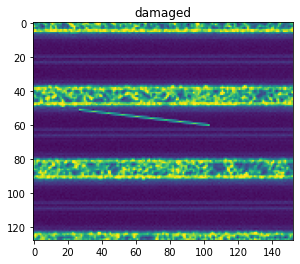

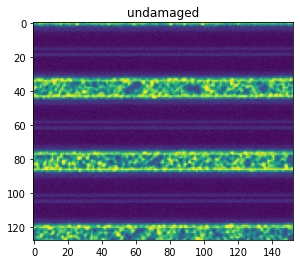

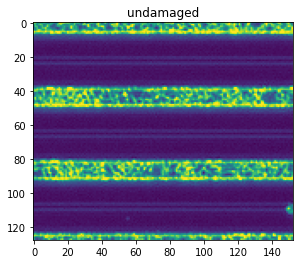

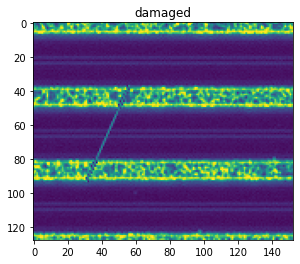

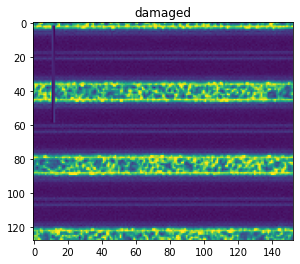

...

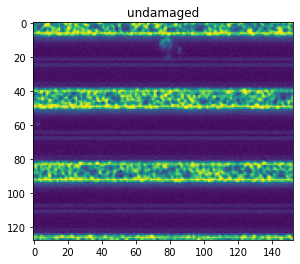

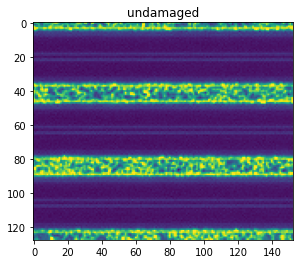

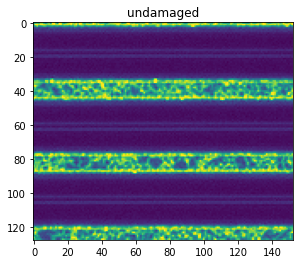

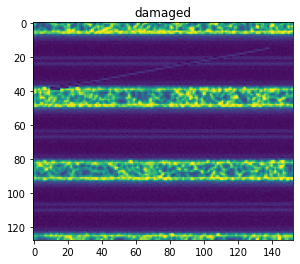

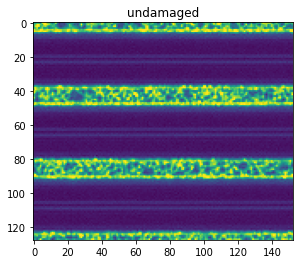

In [13]:
# These plots should show the ones with damage to be titled 1 and those without to be titled 0

for img,label in zip(fullData, fullDataLabels):
    plt.imshow(img)
    plt.clim([0,255])
    plt.title("damaged" if label[0] == 1 else "undamaged")
    plt.show()

In [14]:
# Split into training and test splits

splitIndex = int(len(fullDataLabels)/10)

testData = fullData[:splitIndex]
trainData = fullData[splitIndex:]

testDataLabels = fullDataLabels[:splitIndex]
trainDataLabels = fullDataLabels[splitIndex:]

print(len(testData))
print(len(trainData))

print(len(testDataLabels))
print(len(trainDataLabels))

print(trainData.shape[1:])
print(trainDataLabels.shape)


12
116
12
116
(128, 153)
(116, 2)


In [15]:
import tensorflow as tf
from tensorflow import keras

In [16]:
# Actually build the AI (ugh)



# From: cnn_intro

trainData = trainData.reshape((trainData.shape[0],128*153))
testData = testData.reshape((testData.shape[0],128*153))


# fcn_network = keras.models.Sequential()
#
# Hidden
fcn_network.add(keras.layers.Dense(400,activation='tanh',input_shape=(128*153,)))

# https://stackoverflow.com/questions/61742556/valueerror-shapes-none-1-and-none-2-are-incompatible
#
# Output
fcn_network.add(keras.layers.Dense(2,activation='sigmoid'))
#
# Compile
fcn_network.compile(optimizer='adam',loss='binary_crossentropy',metrics=['accuracy'])
# 
# Fit/save/print summary
history = fcn_network.fit(trainData,trainDataLabels,epochs=100,batch_size=128,validation_data=(testData,testDataLabels))
fcn_network.save('fully_trained_model_fcn.h5')
print(fcn_network.summary())

NameError: name 'fcn_network' is not defined

In [ ]:
# Actually build the AI (ugh)

trainData = trainData.reshape((trainData.shape[0],128,153,1))
testData = testData.reshape((testData.shape[0],128,153,1))

# From: cnn_intro

# https://stackoverflow.com/questions/61742556/valueerror-shapes-none-1-and-none-2-are-incompatible

cnn_network = keras.models.Sequential()
#
# First convolutional layer
cnn_network.add(keras.layers.Conv2D(30,(5,5),activation='relu',input_shape=(128,153,1)))
# Pool
cnn_network.add(keras.layers.MaxPooling2D((2,2)))
#
# Second convolutional layer
cnn_network.add(keras.layers.Conv2D(25,(5,5),activation='relu'))
# Pool
cnn_network.add(keras.layers.MaxPooling2D((2,2)))
#
# Connect to a dense output layer - just like an FCN
cnn_network.add(keras.layers.Flatten())
cnn_network.add(keras.layers.Dense(64,activation='relu'))
cnn_network.add(keras.layers.Dense(2,activation='softmax'))
#
# Compile
cnn_network.compile(optimizer='rmsprop',loss='binary_crossentropy',metrics=['accuracy'])
#
# Fit/save/print summary
history = cnn_network.fit(trainData,trainDataLabels,epochs=500,batch_size=256,validation_data=(testData,testDataLabels))
cnn_network.save('fully_trained_model_cnn.h5')
print(cnn_network.summary())

In [ ]:
trainData.shape